# 1.注意力机制 

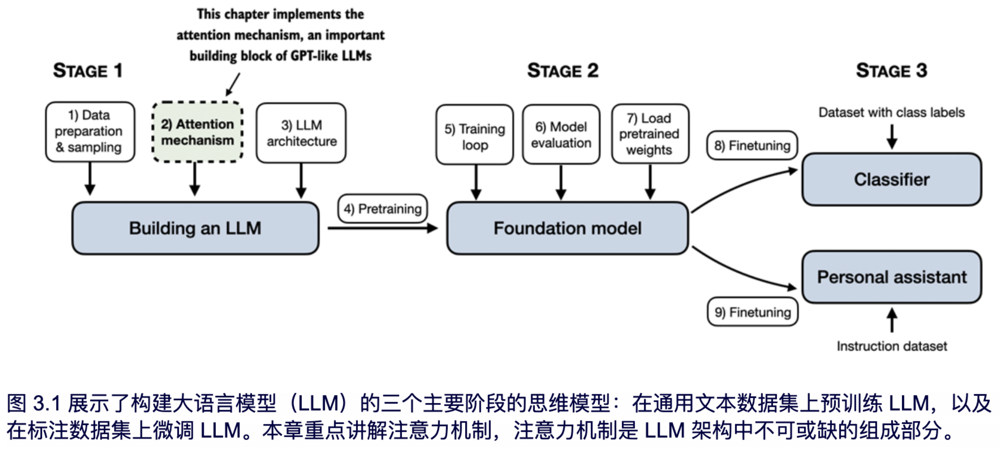  
重点关注LLM中的注意力机制  

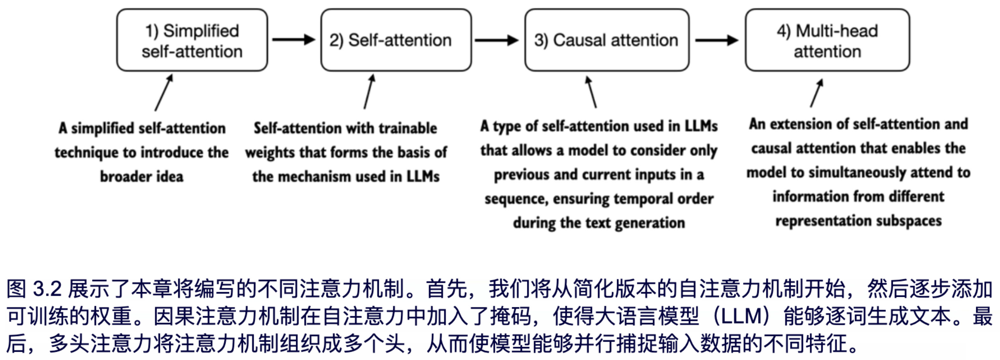

## 1.2 **自注意力机制**

### 1.2.1 简化自注意力机制  
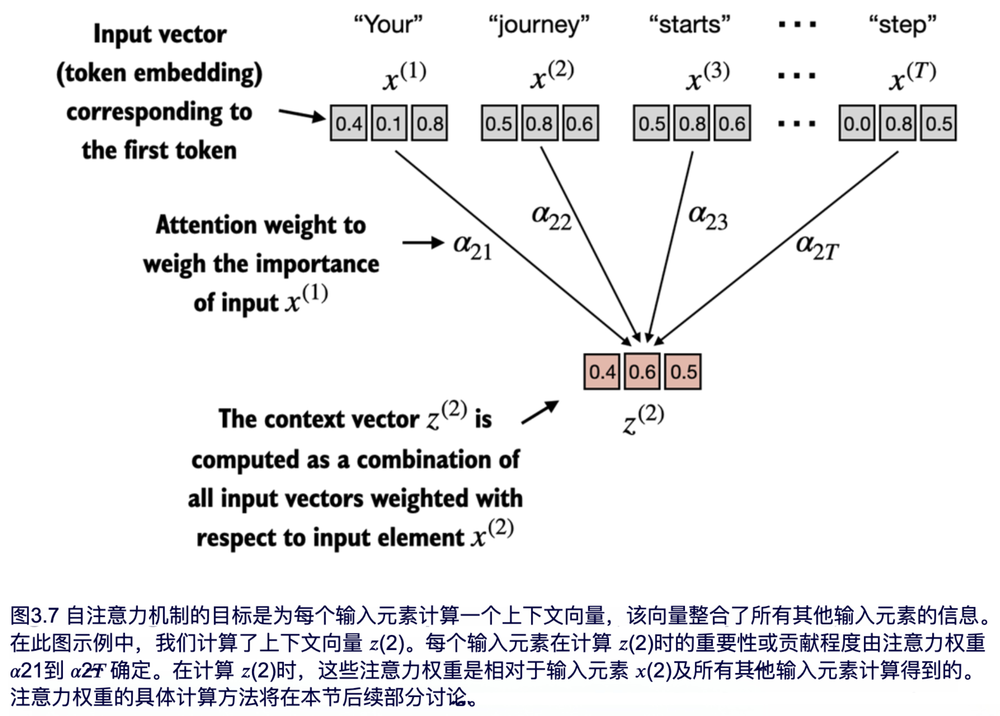

In [1]:
import torch
inputs = torch.tensor(
  [[0.43, 0.15, 0.89], # Your     (x^1)
   [0.55, 0.87, 0.66], # journey  (x^2)
   [0.57, 0.85, 0.64], # starts   (x^3)
   [0.22, 0.58, 0.33], # with     (x^4)
   [0.77, 0.25, 0.10], # one      (x^5)
   [0.05, 0.80, 0.55]] # step     (x^6)
)

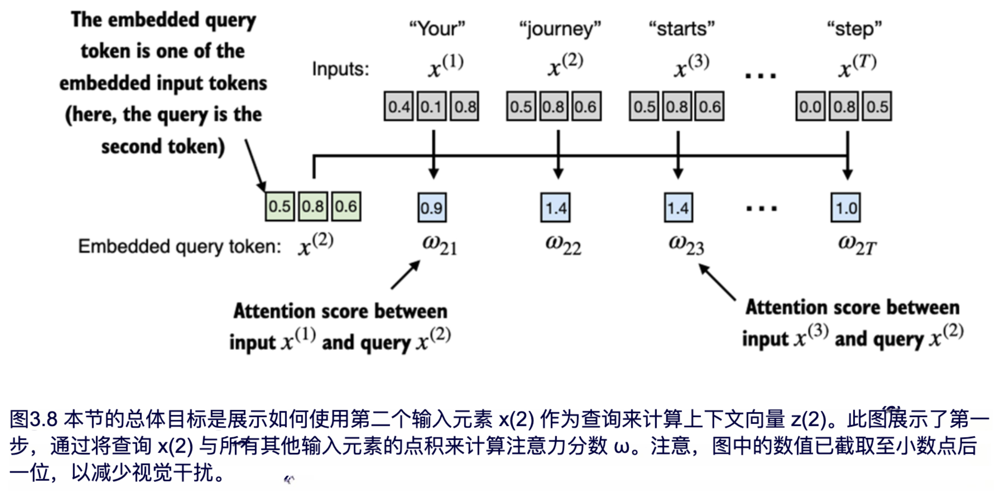  
实现自注意力机制的第一步是计算中间值 ω，即注意力得分，如图 3.8 所示。（请注意，图 3.8 中展示的输入张量值是截断版的，例如，由于空间限制，0.87 被截断为 0.8。在此截断版中，单词 "journey" 和 "starts" 的嵌入向量可能会由于随机因素而看起来相似）。

In [2]:
query = inputs[1]
attn_score_2 = torch.zeros(inputs.shape[0])
for i, x_i in enumerate(inputs):
    attn_score_2[i] = torch.dot(query, x_i)

print(attn_score_2)

tensor([0.9544, 1.4950, 1.4754, 0.8434, 0.7070, 1.0865])


In [3]:
## softmax对注意力得分进行归一化
attn_weight_2 = torch.softmax(attn_score_2, dim=0)
print(sum(attn_weight_2))
attn_weight_2

tensor(1.)


tensor([0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581])

上下文向量 z(2) 是所有输入向量的加权和。其计算方法为将每个输入向量与对应的注意力权重相乘后相加  
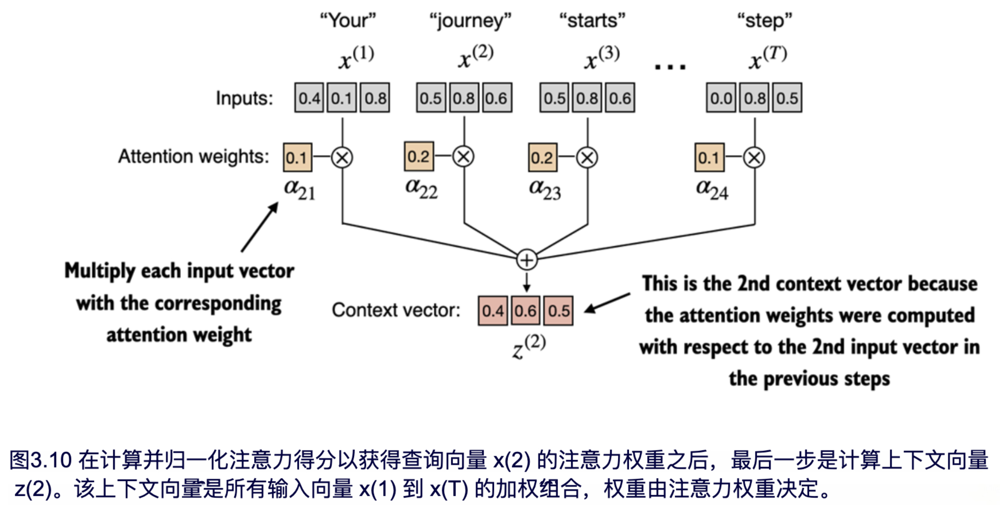

In [4]:
context_vec_2 = torch.zeros(inputs[1].shape[0])
for i, x_i in enumerate(inputs):
    context_vec_2 += x_i*attn_weight_2[i]

context_vec_2 = attn_weight_2 @ inputs#两种形式等价
print(context_vec_2)

tensor([0.4419, 0.6515, 0.5683])


### 1.2.2 为所有token计算上下文向量

In [5]:
#inputs 维度 6*3
#A 计算注意力得分 注意力得分维度 6*6 因为要跟每个token都算一次得分 所以每个token都对应token长度个得分
#B 得分归一化得到权重 6*6 dim=1 合并列 也就是按行求和
#C 计算上下文向量 6*3 权重@inputs

# for-loop 费时间好理解
attn_score = torch.zeros(inputs.shape[0], inputs.shape[0])
for i in range (attn_score.shape[0]):
    for j in range(attn_score.shape[1]):
        attn_score[i,j] = torch.dot(inputs[i], inputs[j])
 
#矩阵乘法 省时间难理解       
attn_score = inputs @ inputs.T
print(attn_score)
test_dim = torch.sum(attn_score, dim=0)
print(test_dim)
atten_weight = torch.softmax(attn_score, dim=1)
print(atten_weight)
print(atten_weight.shape, inputs.shape)
context_vec = torch.matmul(atten_weight, inputs)
context_vec = atten_weight@inputs#两种形式等价
context_vec

tensor([[0.9995, 0.9544, 0.9422, 0.4753, 0.4576, 0.6310],
        [0.9544, 1.4950, 1.4754, 0.8434, 0.7070, 1.0865],
        [0.9422, 1.4754, 1.4570, 0.8296, 0.7154, 1.0605],
        [0.4753, 0.8434, 0.8296, 0.4937, 0.3474, 0.6565],
        [0.4576, 0.7070, 0.7154, 0.3474, 0.6654, 0.2935],
        [0.6310, 1.0865, 1.0605, 0.6565, 0.2935, 0.9450]])
tensor([4.4600, 6.5617, 6.4801, 3.6459, 3.1863, 4.6730])
tensor([[0.2098, 0.2006, 0.1981, 0.1242, 0.1220, 0.1452],
        [0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581],
        [0.1390, 0.2369, 0.2326, 0.1242, 0.1108, 0.1565],
        [0.1435, 0.2074, 0.2046, 0.1462, 0.1263, 0.1720],
        [0.1526, 0.1958, 0.1975, 0.1367, 0.1879, 0.1295],
        [0.1385, 0.2184, 0.2128, 0.1420, 0.0988, 0.1896]])
torch.Size([6, 6]) torch.Size([6, 3])


tensor([[0.4421, 0.5931, 0.5790],
        [0.4419, 0.6515, 0.5683],
        [0.4431, 0.6496, 0.5671],
        [0.4304, 0.6298, 0.5510],
        [0.4671, 0.5910, 0.5266],
        [0.4177, 0.6503, 0.5645]])

## 1.3 带权重的注意力机制  
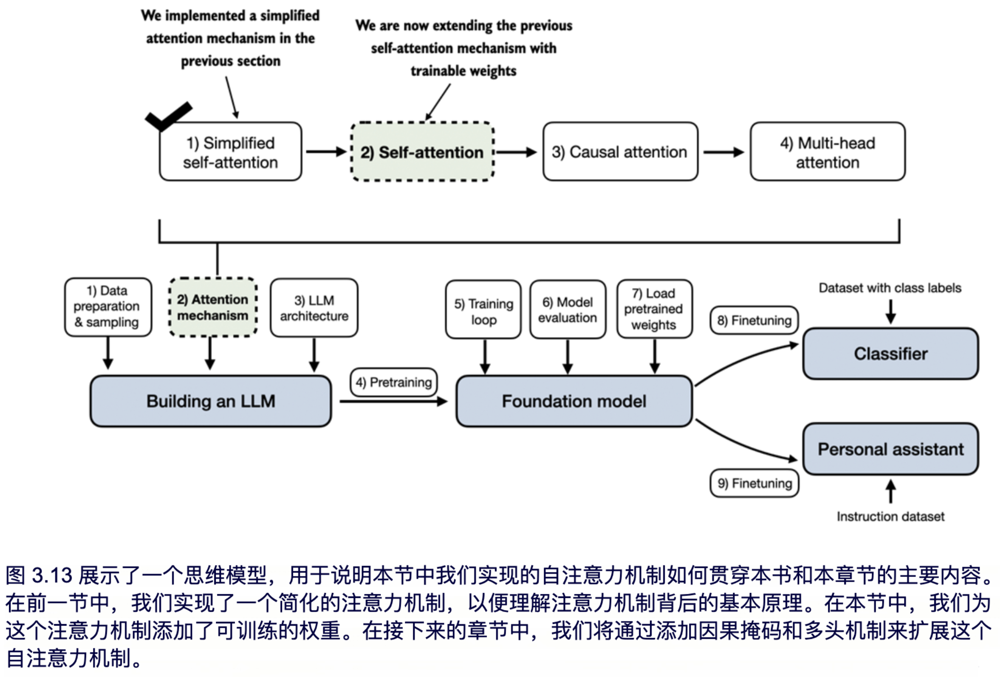

### 1.3.1 逐步计算注意力机制  
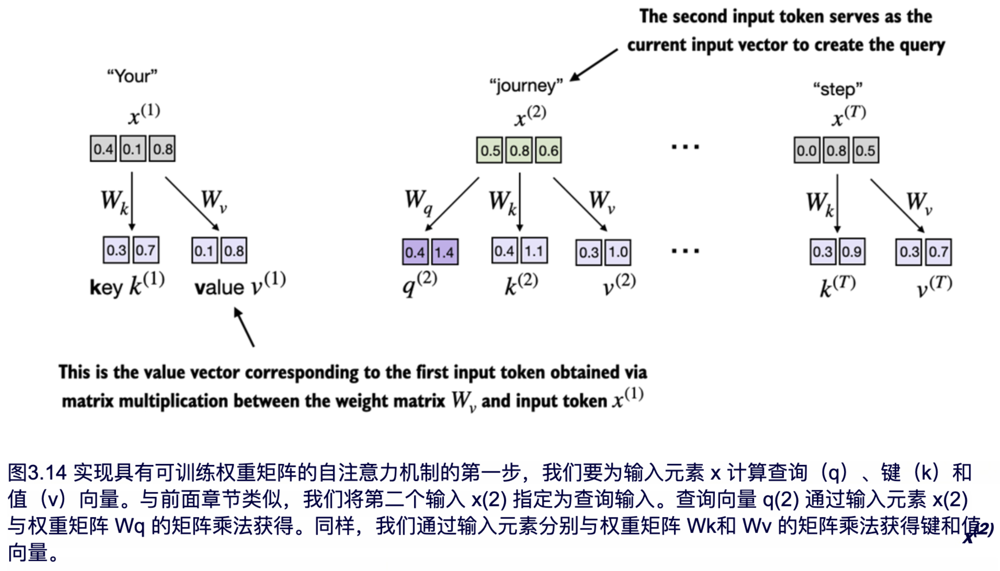

In [6]:
#A 第二个输入元素
#d_in 输入维度
#d_out 输出维度
#在 GPT 类模型中，输入维度和输出维度通常是相同的。
#为了便于说明和更清楚地展示计算过程，我们在此选择了不同的输入（d_in=3）和输出（d_out=2）维度
x_2 = inputs[1]
d_in = 3
d_out = 2
torch.manual_seed(123)
W_query = torch.nn.Parameter(torch.rand(d_in,d_out), requires_grad=False)
W_key = torch.nn.Parameter(torch.rand(d_in,d_out), requires_grad=False)
W_value = torch.nn.Parameter(torch.rand(d_in,d_out), requires_grad=False)
q_2 = x_2 @ W_query
k_2 = x_2 @ W_key
v_2 = x_2 @ W_value
print(f"q:{q_2},k:{k_2},v:{v_2}")

q:tensor([0.4306, 1.4551]),k:tensor([0.4433, 1.1419]),v:tensor([0.3951, 1.0037])


权重参数 VS 注意力权重

请注意，在权重矩阵 W 中，术语“权重”是“权重参数”的缩写，指的是神经网络在训练过程中被优化的数值参数。这与注意力权重不同，注意力权重用于确定上下文向量对输入文本的不同部分的依赖程度，即神经网络对输入不同部分的关注程度。

总之，权重参数是神经网络的基本学习系数，用于定义网络层之间的连接关系，而注意力权重则是根据上下文动态生成的特定值，用于衡量不同词语或位置在当前上下文中的重要性。

In [7]:
keys = inputs @ W_key
values = inputs @ W_value
keys.shape,values.shape 

(torch.Size([6, 2]), torch.Size([6, 2]))

In [8]:
##计算注意力得分w22
keys_2 = keys[1]
attn_score_22 = q_2.dot(k_2)
print(attn_score_22)

tensor(1.8524)


In [9]:
#x2的所有注意力得分 跟其他所有token
attn_score_2 = q_2 @ keys.T
print(attn_score_2)

tensor([1.2705, 1.8524, 1.8111, 1.0795, 0.5577, 1.5440])


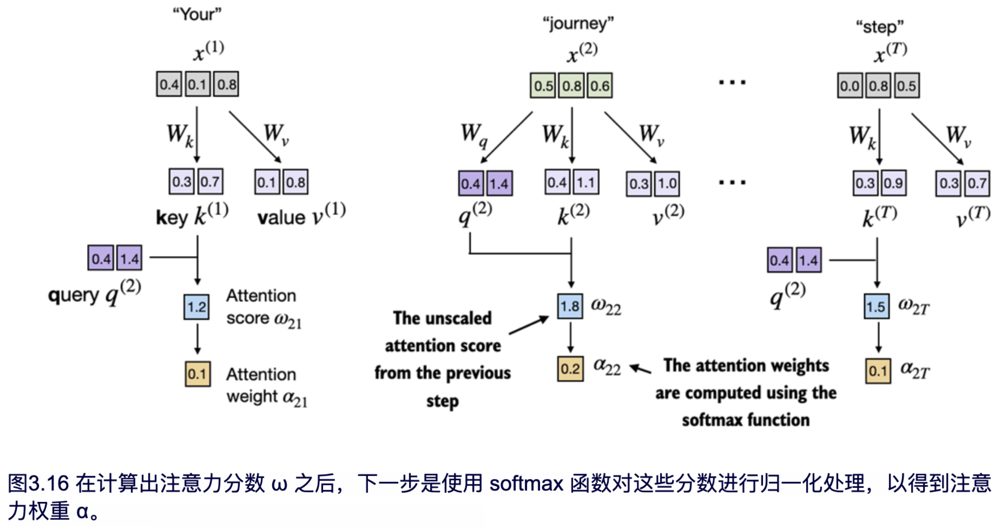

In [10]:
##将注意力得分转换为注意力权重
d_k = keys.shape[-1]
atten_weight_2 = torch.softmax(q_2 @ keys.T / d_k**0.5, dim=-1)
print(attn_weight_2)

tensor([0.1385, 0.2379, 0.2333, 0.1240, 0.1082, 0.1581])


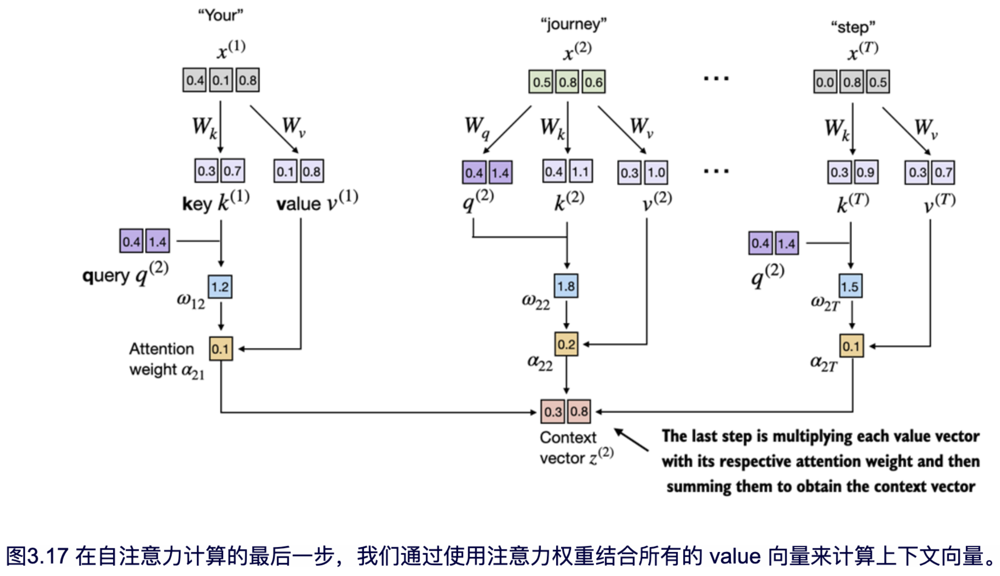

In [11]:
## 计算上下文向量
context_vec_2 = atten_weight_2 @ values
context_vec_2

tensor([0.3061, 0.8210])

为什么使用Q、K和V向量？

在注意力机制的上下文中，“键”（key）、“查询”（query）和“值”（value）这些术语来源于信息检索和数据库领域，在这些领域中也使用类似的概念来存储、搜索和检索信息

查询（query）类似于数据库中的搜索查询。它代表模型当前关注或试图理解的项（如句子中的某个词或 token）。通过查询，模型可以探查输入序列中的其他部分，以确定对它们应关注的程度。

键（key）类似于数据库中用于索引和查找的键。在注意力机制中，输入序列的每个元素（例如句子中的每个单词）都对应一个关联的‘键’。这些‘键’用于与‘查询’进行匹配。

值（value）类似于数据库中的键值对中的“值”。它表示输入项的实际内容或表示。当模型确定哪些键（即输入中的哪些部分）与查询（当前的关注项）最相关时，就会检索出对应的值

### 1.3.2 **下面将实现一个完整的输入上下文向量！**

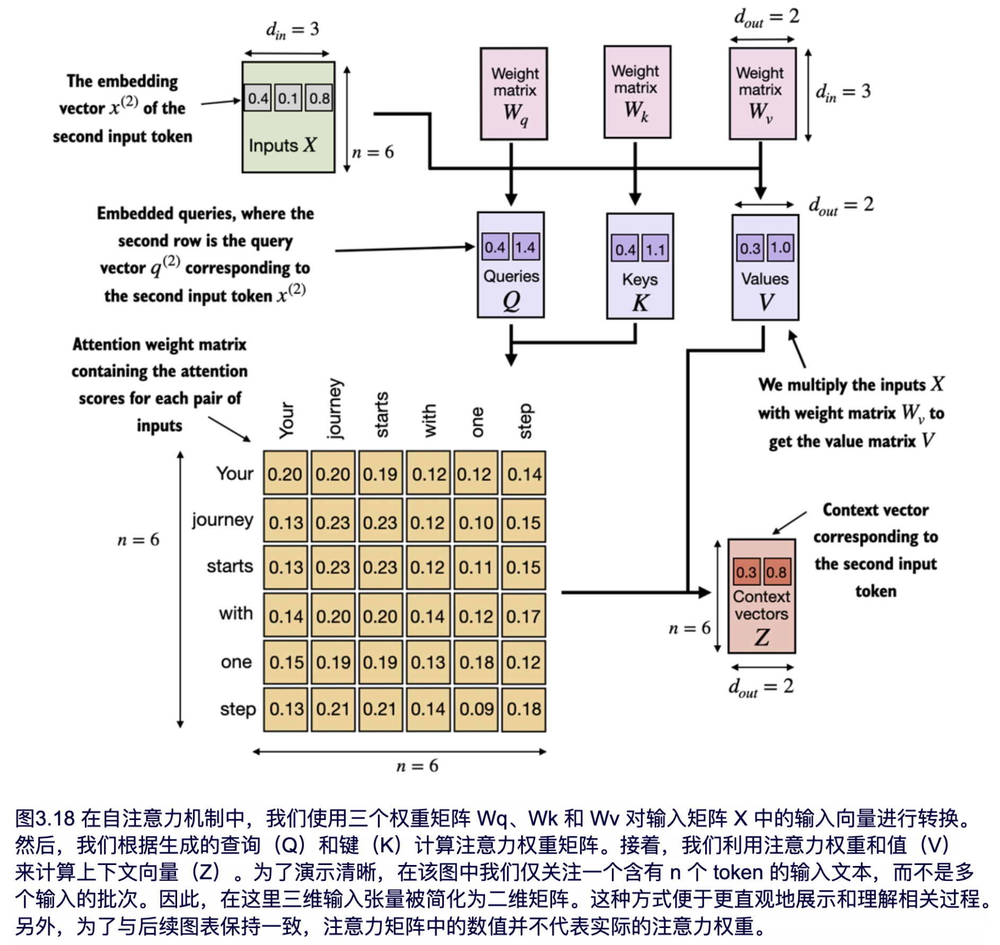

In [12]:
from torch import nn 
class SelfAttention_v1(nn.Module):
    def __init__(self, d_in, d_out):
        super().__init__()
        self.d_in = d_in
        self.d_out = d_out
        self.W_key = nn.Parameter(torch.rand(d_in, d_out))
        self.W_query = nn.Parameter(torch.rand(d_in, d_out))
        self.W_value = nn.Parameter(torch.rand(d_in, d_out))
    
    def forward(self, x):
        query = x @ self.W_query
        key = x @ self.W_key
        value = x @ self.W_value
        atten_score = query @ key.T
        atten_weight = torch.softmax(atten_score / key.shape[-1] ** 0.5, dim=-1)
        context_vec = atten_weight @ value
        return context_vec
    
torch.manual_seed(123)
sa_v1 = SelfAttention_v1(d_in, d_out)
print(sa_v1(inputs))

tensor([[0.2947, 0.7956],
        [0.3015, 0.8132],
        [0.3010, 0.8120],
        [0.2925, 0.7902],
        [0.2863, 0.7737],
        [0.2979, 0.8043]], grad_fn=<MmBackward0>)


我们可以通过使用 PyTorch 的 nn.Linear 层来进一步改进 SelfAttention_v1 的实现。当禁用偏置单元时，nn.Linear 层可以有效地执行矩阵乘法。此外，使用 nn.Linear 替代手动实现的 nn.Parameter(torch.rand(...)) 的一个显著优势在于，nn.Linear 具有优化的权重初始化方案，从而有助于实现更稳定和更高效的模型训练。

In [13]:
from torch import nn 
class SelfAttention_v2(nn.Module):
    def __init__(self, d_in, d_out, qkv_bias=False):
        super().__init__()
        self.d_in = d_in
        self.d_out = d_out
        self.W_key = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
        self.W_query = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
        self.W_value = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
    
    def forward(self, x):
        query = self.W_query(x)
        key = self.W_key(x)
        value = self.W_value(x)
        atten_score = query @ key.T
        atten_weight = torch.softmax(atten_score / key.shape[-1] ** 0.5, dim=-1)
        context_vec = atten_weight @ value
        return context_vec
    
torch.manual_seed(789)
sa_v2 = SelfAttention_v2(d_in, d_out)
print(sa_v2(inputs))

tensor([[-0.0809,  0.0638],
        [-0.0784,  0.0657],
        [-0.0784,  0.0657],
        [-0.0772,  0.0666],
        [-0.0787,  0.0652],
        [-0.0769,  0.0669]], grad_fn=<MmBackward0>)


### 1.3.3 因果注意力机制  
在 GPT 类大语言模型中，要实现这一点，我们需要对每个处理的 token 屏蔽其后续 token，即在输入文本中当前词之后的所有词，如图 3.19 所示。  
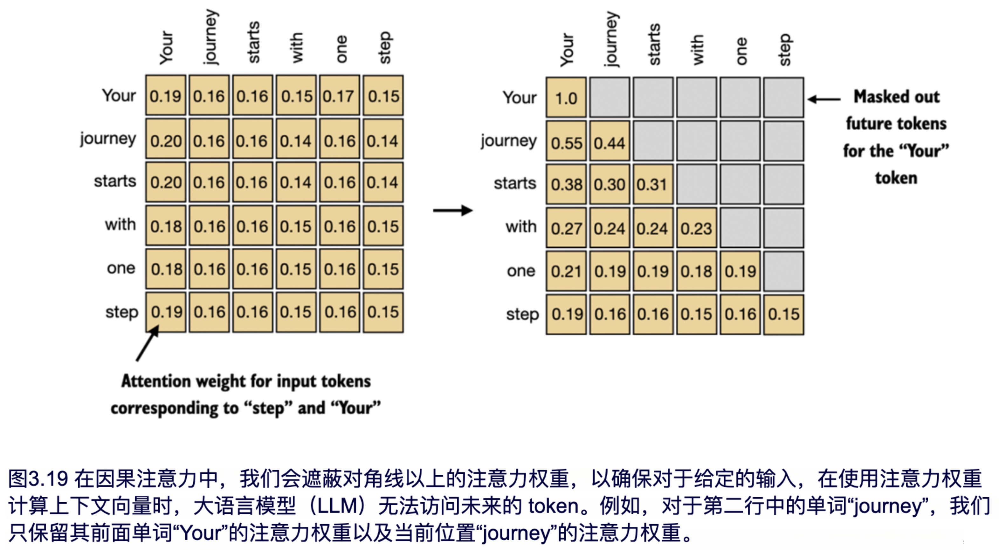

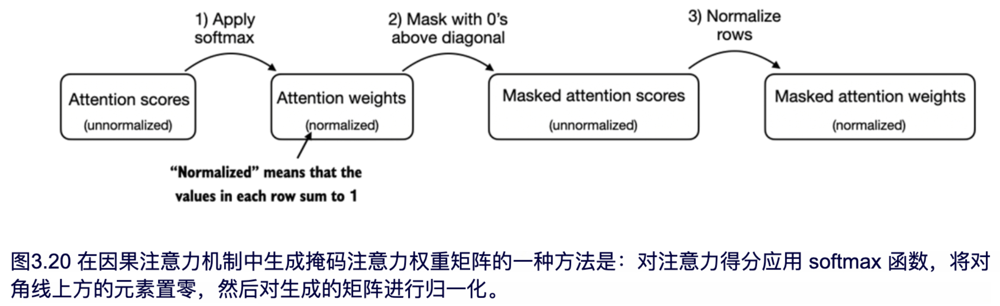

In [14]:
queries = sa_v2.W_query(inputs)
keys = sa_v2.W_key(inputs)
values = sa_v2.W_value(inputs)
attn_score = queries @ keys.T
attn_score

tensor([[ 0.2899,  0.4656,  0.4594,  0.2642,  0.2183,  0.3408],
        [ 0.0716,  0.1723,  0.1703,  0.1024,  0.0874,  0.1270],
        [ 0.0760,  0.1751,  0.1731,  0.1036,  0.0882,  0.1290],
        [-0.0138,  0.0259,  0.0259,  0.0186,  0.0177,  0.0198],
        [ 0.1344,  0.1771,  0.1745,  0.0973,  0.0786,  0.1290],
        [-0.0511,  0.0085,  0.0090,  0.0122,  0.0144,  0.0078]],
       grad_fn=<MmBackward0>)

In [15]:
content_length = attn_score.shape[0]
mask_simple = torch.tril(torch.ones((content_length, content_length)))
print(mask_simple)

tensor([[1., 0., 0., 0., 0., 0.],
        [1., 1., 0., 0., 0., 0.],
        [1., 1., 1., 0., 0., 0.],
        [1., 1., 1., 1., 0., 0.],
        [1., 1., 1., 1., 1., 0.],
        [1., 1., 1., 1., 1., 1.]])


In [16]:
masked_simple = attn_score * mask_simple
print(masked_simple)

tensor([[ 0.2899,  0.0000,  0.0000,  0.0000,  0.0000,  0.0000],
        [ 0.0716,  0.1723,  0.0000,  0.0000,  0.0000,  0.0000],
        [ 0.0760,  0.1751,  0.1731,  0.0000,  0.0000,  0.0000],
        [-0.0138,  0.0259,  0.0259,  0.0186,  0.0000,  0.0000],
        [ 0.1344,  0.1771,  0.1745,  0.0973,  0.0786,  0.0000],
        [-0.0511,  0.0085,  0.0090,  0.0122,  0.0144,  0.0078]],
       grad_fn=<MulBackward0>)


In [17]:
row_sum = masked_simple.sum(dim=-1, keepdim=True)
norm_simple = masked_simple / row_sum
print(norm_simple)


tensor([[  1.0000,   0.0000,   0.0000,   0.0000,   0.0000,   0.0000],
        [  0.2937,   0.7063,   0.0000,   0.0000,   0.0000,   0.0000],
        [  0.1792,   0.4127,   0.4080,   0.0000,   0.0000,   0.0000],
        [ -0.2438,   0.4578,   0.4570,   0.3290,   0.0000,   0.0000],
        [  0.2030,   0.2676,   0.2637,   0.1470,   0.1187,   0.0000],
        [-66.7978,  11.1191,  11.7039,  15.9714,  18.8695,  10.1339]],
       grad_fn=<DivBackward0>)


为了方便使用softmax 把右上角变成-inf


In [18]:
mask = torch.triu(torch.ones((content_length, content_length)), diagonal=1)
print(mask)
masked = attn_score.masked_fill(mask.bool(), -torch.inf)
masked

tensor([[0., 1., 1., 1., 1., 1.],
        [0., 0., 1., 1., 1., 1.],
        [0., 0., 0., 1., 1., 1.],
        [0., 0., 0., 0., 1., 1.],
        [0., 0., 0., 0., 0., 1.],
        [0., 0., 0., 0., 0., 0.]])


tensor([[ 0.2899,    -inf,    -inf,    -inf,    -inf,    -inf],
        [ 0.0716,  0.1723,    -inf,    -inf,    -inf,    -inf],
        [ 0.0760,  0.1751,  0.1731,    -inf,    -inf,    -inf],
        [-0.0138,  0.0259,  0.0259,  0.0186,    -inf,    -inf],
        [ 0.1344,  0.1771,  0.1745,  0.0973,  0.0786,    -inf],
        [-0.0511,  0.0085,  0.0090,  0.0122,  0.0144,  0.0078]],
       grad_fn=<MaskedFillBackward0>)

In [19]:
atten_weight = torch.softmax(masked / keys.shape[-1], dim=-1)
print(atten_weight)

tensor([[1.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.4874, 0.5126, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.3225, 0.3389, 0.3386, 0.0000, 0.0000, 0.0000],
        [0.2465, 0.2515, 0.2515, 0.2506, 0.0000, 0.0000],
        [0.2002, 0.2045, 0.2042, 0.1965, 0.1947, 0.0000],
        [0.1624, 0.1674, 0.1674, 0.1677, 0.1679, 0.1673]],
       grad_fn=<SoftmaxBackward0>)


In [20]:
content_vec = atten_weight @ values
print(content_vec)

tensor([[-0.0872,  0.0286],
        [-0.1008,  0.0532],
        [-0.1011,  0.0666],
        [-0.0985,  0.0490],
        [-0.0523,  0.1095],
        [-0.0770,  0.0668]], grad_fn=<MmBackward0>)


### 1.3.4 使用dropout  
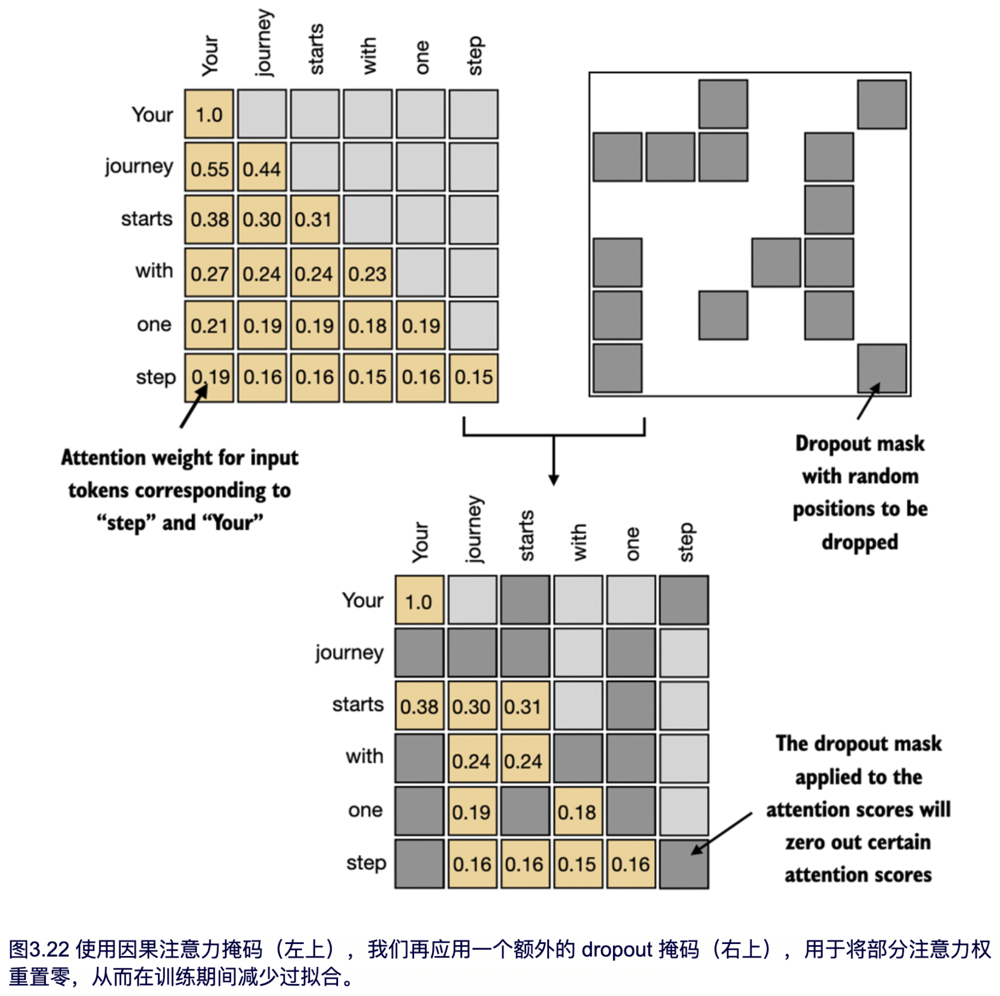

In [21]:
torch.manual_seed(123)
dropout = nn.Dropout()
example = torch.ones((6,6))
print(dropout(example))

tensor([[2., 2., 0., 2., 2., 0.],
        [0., 0., 0., 2., 0., 2.],
        [2., 2., 2., 2., 0., 2.],
        [0., 2., 2., 0., 0., 2.],
        [0., 2., 0., 2., 0., 2.],
        [0., 2., 2., 2., 2., 0.]])


In [22]:
print(dropout(atten_weight))

tensor([[2.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.6778, 0.6771, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.5029, 0.5011, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.0000, 0.3893, 0.0000],
        [0.3249, 0.3347, 0.0000, 0.3353, 0.3357, 0.3346]],
       grad_fn=<MulBackward0>)


### 1.3.5 实现因果注意力类

In [23]:
#A 与之前的 SelfAttention_v1 类相比，我们添加了一个 dropout 层
#B register_buffer 调用也是新添加的内容（后续内容会提供更多相关信息）
#C 我们交换第 1 和第 2 个维度，同时保持批次维度在第1个位置（索引0）
#D 在 PyTorch 中，带有下划线后缀的操作会在原有内存空间执行，直接修改变量本身，从而避免不必要的内存拷贝
class CausalAttention(nn.Module):
    def __init__(self, d_in, d_out, context_lenth,dropout, qkv_bias=False):
        super().__init__()
        self.d_in = d_in
        self.d_out = d_out
        self.dropout = nn.Dropout(dropout)
        self.W_query = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
        self.W_key = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
        self.W_value = nn.Linear(in_features=d_in, out_features=d_out, bias=qkv_bias)
        self.register_buffer(
            'mask',
            torch.triu(torch.ones(context_lenth, context_lenth), diagonal=1)
        )
    
    def forward(self, x):
        b, num_tokens, d_in = x.shape
        queries = self.W_query(x)
        keys = self.W_key(x)
        values = self.W_value(x)
        atten_score = queries @ keys.transpose(1,2)
        atten_score.masked_fill_(self.mask.bool()[:num_tokens, :num_tokens], -torch.inf)
        atten_weight = torch.softmax(atten_score / keys.shape[-1] ** 0.5,dim=-1)
        atten_weight = self.dropout(atten_weight)
        context_vec = atten_weight @ values
        return context_vec

In [24]:
batch = torch.stack((inputs, inputs), dim=0)
print(batch.shape)    

torch.Size([2, 6, 3])


In [25]:
torch.manual_seed(123)
context_length = batch.shape[1]
ca = CausalAttention(d_in, d_out, context_length, 0.0)
context_vecs = ca(batch)
print("context_vecs.shape:", context_vecs.shape)

context_vecs.shape: torch.Size([2, 6, 2])


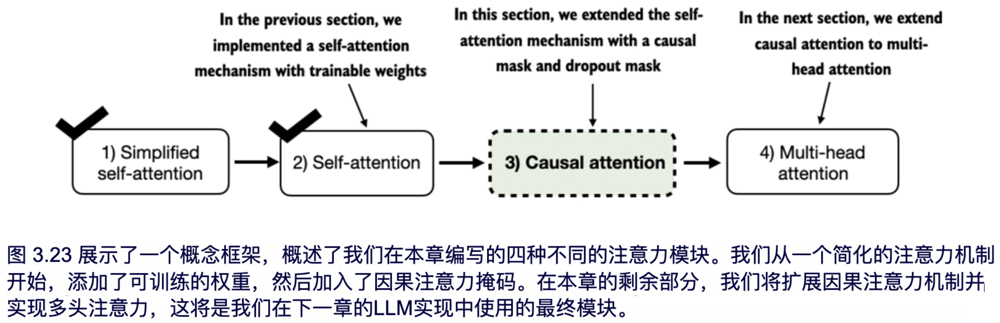

### 1.3.6 从单头注意力扩展到多头注意力

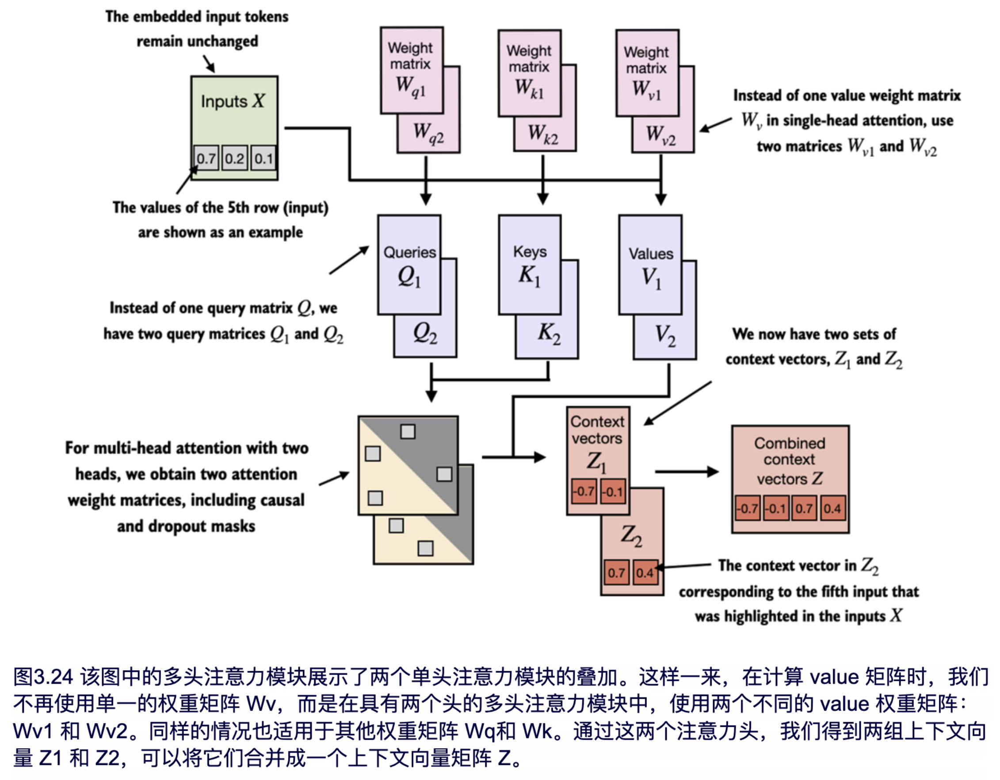

#### 1.3.6.1 堆叠多层单头注意力层  
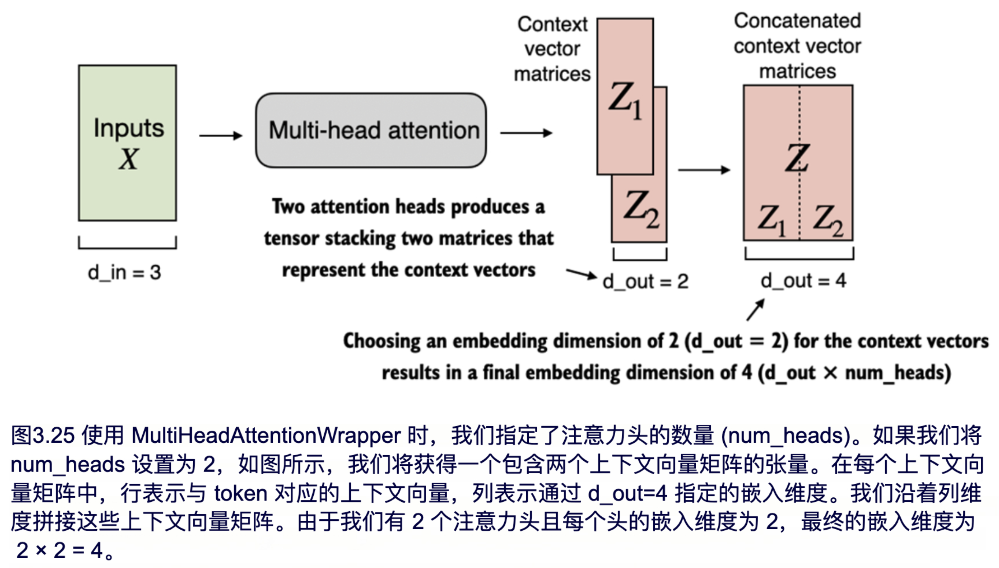

In [ ]:
#堆叠多层单头注意力层 输出content_vec特征维度为 d_out * num_heads
class MultiHeadAttentionWrapper(nn.Module):
    def __init__(self, d_in, d_out, context_length, dropout, num_heads, qkv_bias=False):
        super().__init__()
        self.heads = nn.ModuleList(
            [
                CausalAttention(d_in,d_out,context_length,dropout,qkv_bias=qkv_bias)
                for _ in range(num_heads)
            ]
        )
    
    def forward(self, x):
        return torch.concat([head(x) for head in self.heads], dim=-1)




In [27]:
print(batch)

tensor([[[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]],

        [[0.4300, 0.1500, 0.8900],
         [0.5500, 0.8700, 0.6600],
         [0.5700, 0.8500, 0.6400],
         [0.2200, 0.5800, 0.3300],
         [0.7700, 0.2500, 0.1000],
         [0.0500, 0.8000, 0.5500]]])


In [28]:
torch.manual_seed(123)
d_in = 3
d_out = 2
context_lenth = batch.shape[1]
mha = MultiHeadAttentionWrapper(d_in,d_out,context_length,0.0,num_heads=2)
print(mha(batch).shape)

torch.Size([2, 6, 4])


#### 1.3.6.2通过权重分割实现多头注意力机制  

In [ ]:
class MultiHeadAttention(nn.Module):
    def __init__(self,d_in,d_out,context_length,num_heads,dropout,qkv_bias=False):
        super().__init__()
        assert d_out % num_heads == 0, "d_out must be divisible by num_heads"
        self.d_in = d_in
        self.d_out = d_out
        self.context_length = context_length
        self.num_heads = num_heads
        self.head_dim = d_out // num_heads # 必须是整除
        self.dropout = nn.Dropout(dropout)
        self.W_q = nn.Linear(in_features=d_in, out_features=d_out,bias=qkv_bias)
        self.W_k = nn.Linear(in_features=d_in, out_features=d_out,bias=qkv_bias)
        self.W_v = nn.Linear(in_features=d_in, out_features=d_out,bias=qkv_bias)
        self.out_proj = nn.Linear(in_features=d_out, out_features=d_out)
        self.register_buffer(
            'mask',
            torch.triu(torch.ones(context_length, context_length),diagonal=1)
        )
        
    def forward(self, x):
        b, num_tokens, d_in =x.shape
        queries = self.W_q(x).view(b, num_tokens, self.num_heads, self.head_dim)
        keys = self.W_k(x).view(b, num_tokens, self.num_heads, self.head_dim)
        values = self.W_v(x).view(b, num_tokens, self.num_heads, self.head_dim)
        queries = queries.transpose(1,2) # [b, num_heads, num_tokens, head_dim]
        keys = keys.transpose(1,2)
        values = values.transpose(1,2)
        atten_scroe = queries @ keys.transpose(2,3) / keys.shape[-1] ** 0.5
        mask_bool = self.mask.bool()[:num_tokens, :num_tokens]
        atten_scroe.masked_fill_(mask_bool, -torch.inf)
        atten_weight = torch.softmax(atten_scroe, dim=-1)
        atten_weight = self.dropout(atten_weight)
        content_vec = atten_weight @ values# [b, num_heads, num_tokens, head_dim]
        content_vec = content_vec.transpose(1,2).contiguous().view(b, num_tokens, self.d_out)# [b, num_tokens, d_out]
        content_vec = self.out_proj(content_vec)
        return content_vec

In [37]:
torch.manual_seed(123)
batch_size, context_length, d_in = batch.shape
d_out = 2
mha = MultiHeadAttention(d_in, d_out, context_length, num_heads=2, dropout=0.0)
context_vecs = mha(batch)
print(context_vecs)
print("context_vecs.shape:", context_vecs.shape)

tensor([[[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028]],

        [[0.3190, 0.4858],
         [0.2943, 0.3897],
         [0.2856, 0.3593],
         [0.2693, 0.3873],
         [0.2639, 0.3928],
         [0.2575, 0.4028]]], grad_fn=<ViewBackward0>)
context_vecs.shape: torch.Size([2, 6, 2])


In [38]:
gpt_mua = MultiHeadAttention(d_in=768, d_out=768, context_length=1024, num_heads=12, dropout=0.5)
test = torch.randn((2,1024,768))
print(gpt_mua(test).shape)

torch.Size([2, 1024, 768])


**Summary**  
- 注意力机制将输入元素转换为增强的上下文向量表示，其中包含了所有输入的信息。
- 自注意力机制通过对输入的加权求和来计算上下文向量表示。
- 在简化的注意力机制中，注意力权重是通过点积计算的。
- 点积仅仅是对两个向量逐元素相乘后求和的一种简洁方式。
- 矩阵乘法虽然并不是绝对必要的，但通过替换嵌套的 for 循环，它帮助我们更高效和简洁地计算。
- 在 LLM 中使用的自注意力机制，也称为缩放点积注意力，我们引入可训练的权重矩阵，以计算输入的中间转换：查询、值和键。
- 在使用从左到右读取和生成文本的 LLM 时，我们添加一个因果注意力掩码，以防止模型访问未来的 token。
- 除了通过因果注意力掩码将注意力权重置为零之外，我们还可以添加 dropout 掩码，以减少 LLM 中的过拟合现象。
- 基于Transformer的 LLM 中的注意力模块包含多个因果注意力实例，这被称为多头注意力。
- 我们可以通过堆叠多个因果注意力模块的实例来创建一个多头注意力模块。
- 创建多头注意力模块的一种更高效的方法是采用批量矩阵乘法。
